In [2]:
%load_ext lab_black
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
from pathlib import Path
import requests
import itertools
import re
import sys
from matplotlib.ticker import PercentFormatter
import scanpy as sc
import anndata as ad
import cello
from statannot import add_stat_annotation
from statannotations.Annotator import Annotator
import harmonypy as hm
from scipy import stats
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

%matplotlib inline
show_plot = True

/Users/senosam/opt/anaconda3/lib/python3.7/site-packages/numba/core/errors.py:149: UserWarning: Insufficiently recent colorama version found. Numba requires colorama >= 0.3.9
  warnings.warn(msg)


## Read data

In [3]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

In [4]:
path_raw = "../../data/TMA36_project/sc_RNAseq/processed/count cell ranger"
ls = os.listdir(path_raw)
path_ls = []
for i in ls:
    path_ls.append(Path("/".join([path_raw, i, "filtered_feature_bc_matrix.h5"])))
results_file = "../../data/TMA36_project/sc_RNAseq/processed/analyzed/all_samples.h5ad"  # the file that will store the analysis results

In [5]:
pt_info = pd.read_excel(
    "../../data/TMA36_project/sc_RNAseq/processed/VANTAGE_info.xlsx",
    sheet_name="Sheet2",
)
pt_info_dict = pt_info.set_index("Sample_ID").astype(str).agg(" ".join, 1).to_dict()
sample_names = [x.parent.name.strip() for x in path_ls]
sample_names = (pd.Series(sample_names)).map(pt_info_dict).to_list()

In [5]:
adatas = [sc.read_10x_h5(filename, gex_only=False) for filename in path_ls]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

In [6]:
for i, adata in enumerate(adatas):
    adata.var_names_make_unique()
    adata.obs["sample"] = sample_names[i]

In [7]:
# Remove patient 7984 due to low cell count
del adatas[9]

In [8]:
# concatenate the datasets
# adata = adatas[0].concatenate(adatas[1:])
adata = ad.concat(adatas, merge="same")
# dataset.subsample_genes(4000)

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


In [9]:
adata.obs_names_make_unique()

In [10]:
samples_size = adata.obs["sample"].value_counts().sort_index()
samples_size

11522    5290
11817    3618
11918     383
12889    3310
12929    1524
12935    2074
13634    5221
13636    2591
13774    2938
14428    6744
14958    2871
14965    2791
15002    7944
15467    6514
8356      380
Name: sample, dtype: int64

## Gene filtering and preprocessing

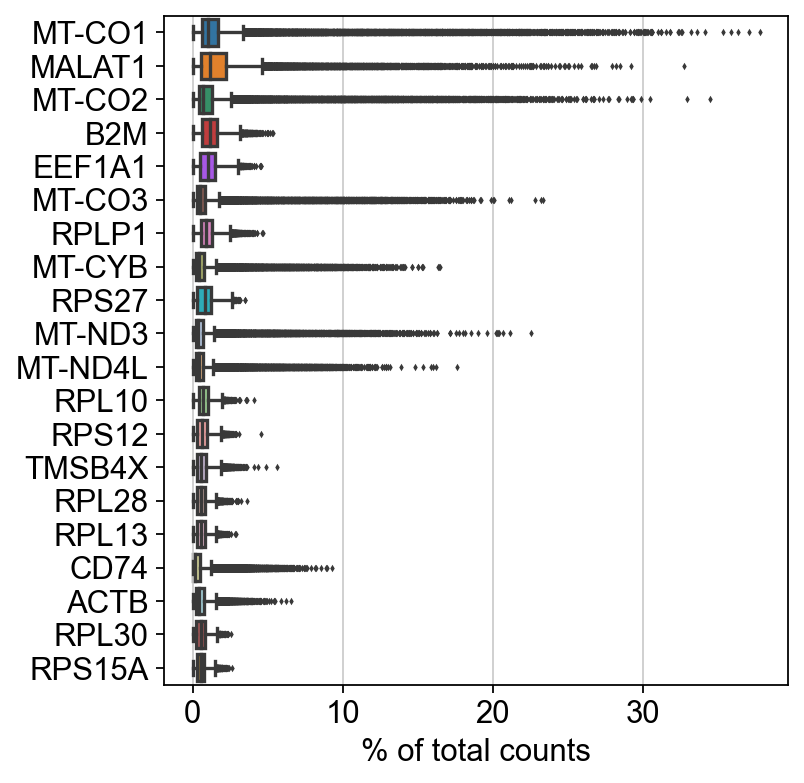

In [11]:
sc.pl.highest_expr_genes(
    adata,
    n_top=20,
)

In [12]:
# basic filtering
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [13]:
adata.var["mt"] = adata.var_names.str.startswith(
    "MT-"
)  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

In [14]:
adata.var[adata.var.index == "FAP"]

,feature_types,genome,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
FAP,Gene Expression,GRCh38,1764,False,1764,0.088422,96.653577,4661.0


... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


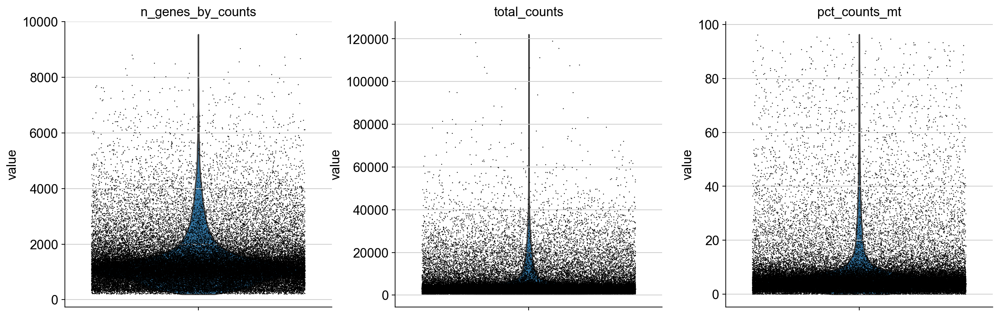

In [15]:
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

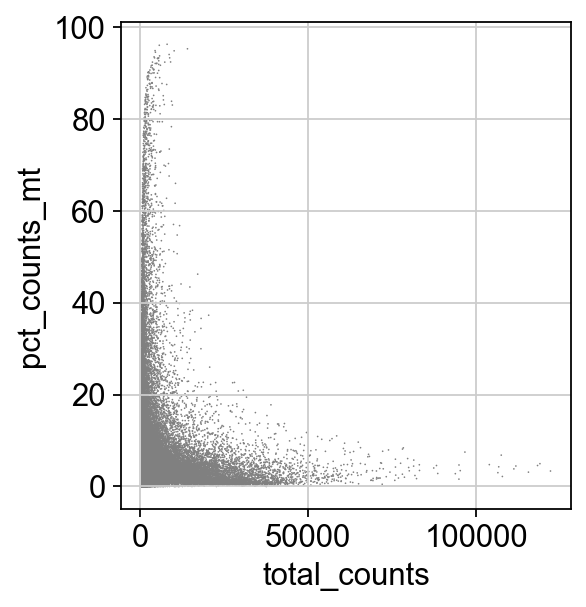

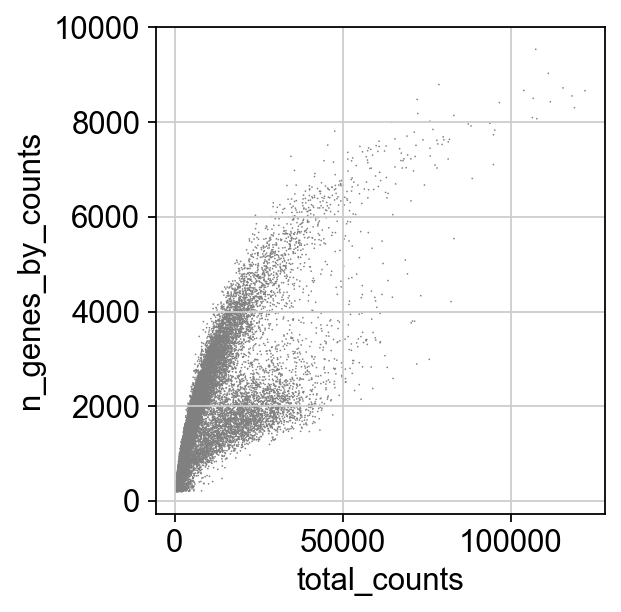

In [16]:
sc.pl.scatter(adata, x="total_counts", y="pct_counts_mt")
sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts")

In [17]:
# Actually do the filtering by slicing the AnnData object
adata = adata[adata.obs.n_genes_by_counts < 3000, :]
adata = adata[adata.obs.pct_counts_mt < 17, :]

In [18]:
# Total-count normalize (library-size correct) the data matrix  𝐗  to 10,000
# reads per cell, so that counts become comparable among cells.
sc.pp.normalize_total(adata, target_sum=1e4)

/Users/senosam/opt/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [19]:
# Logarithmize the data
sc.pp.log1p(adata)

In [20]:
# identify highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

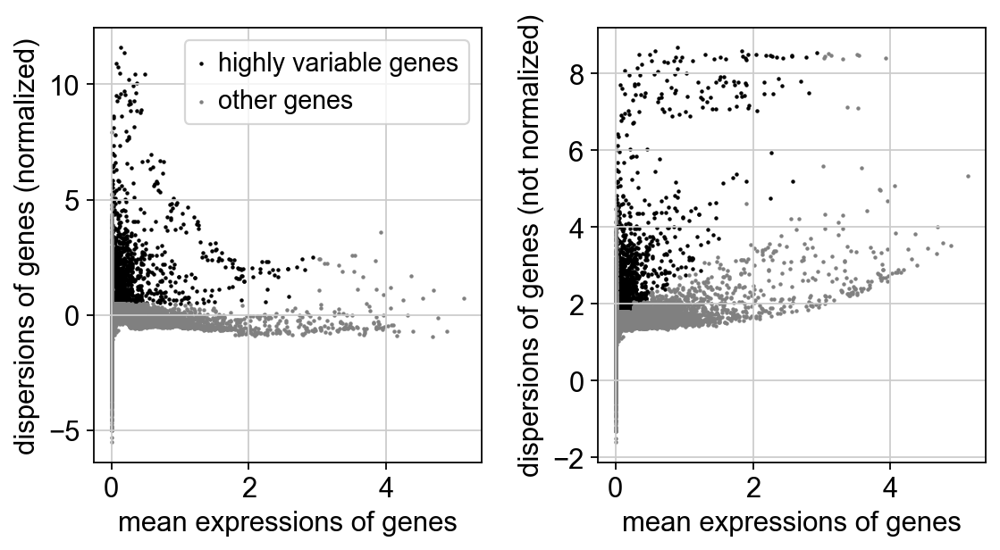

In [21]:
sc.pl.highly_variable_genes(adata)

In [22]:
adata

AnnData object with n_obs × n_vars = 44876 × 23905
    obs: 'sample', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [23]:
# Set the .raw attribute of the AnnData object to the normalized and
# logarithmized raw gene expression for later use in differential testing and visualizations of gene expression.
adata.raw = adata

In [24]:
# filtering
adata = adata[:, adata.var.highly_variable]

In [25]:
# Regress out effects of total counts per cell and the percentage
# of mitochondrial genes expressed
sc.pp.regress_out(adata, ["total_counts", "pct_counts_mt"])

In [26]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10
sc.pp.scale(adata, max_value=10)

In [27]:
sc.tl.pca(adata, svd_solver="arpack")

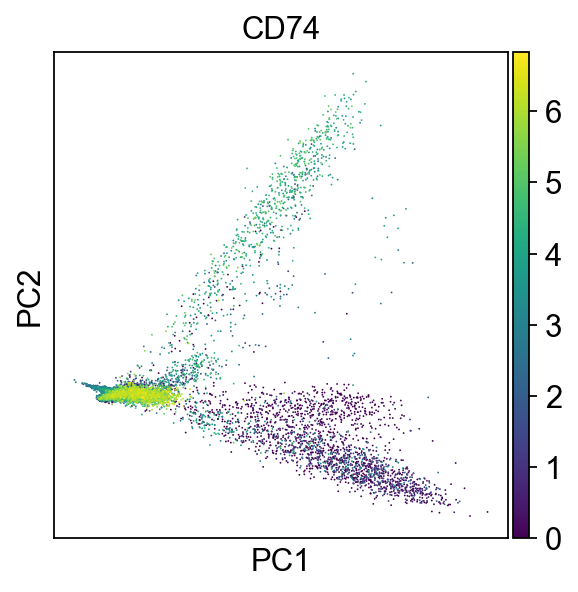

In [28]:
sc.pl.pca(adata, color="CD74")

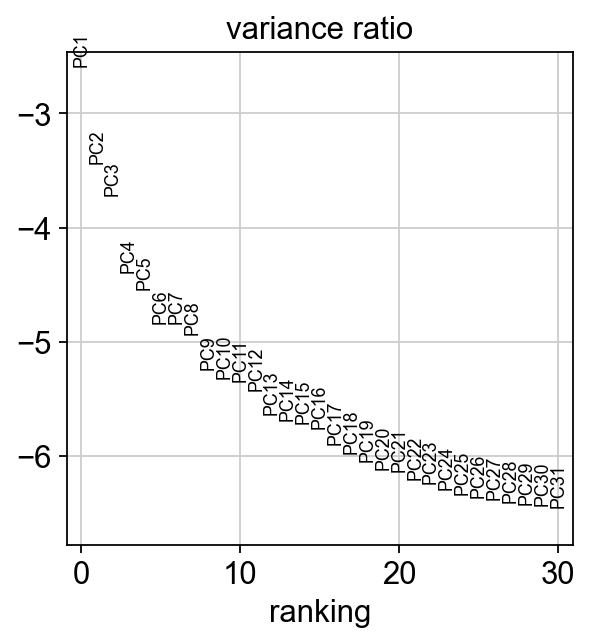

In [29]:
sc.pl.pca_variance_ratio(adata, log=True)

In [30]:
# computing neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=27)

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [31]:
sc.tl.umap(adata, random_state=101)

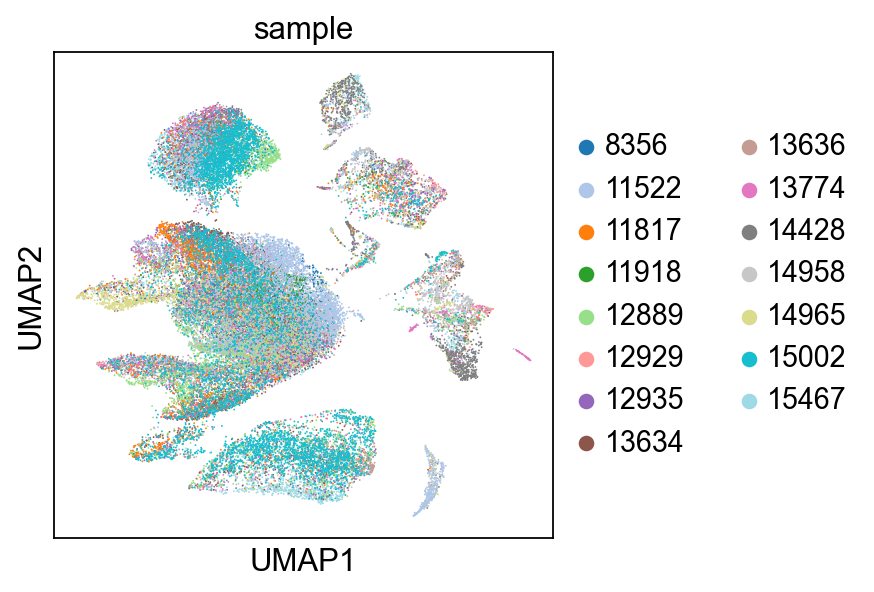

In [32]:
sc.pl.umap(adata, color="sample", palette="tab20")

In [34]:
# clustering the neighborhood graph
sc.tl.leiden(adata)

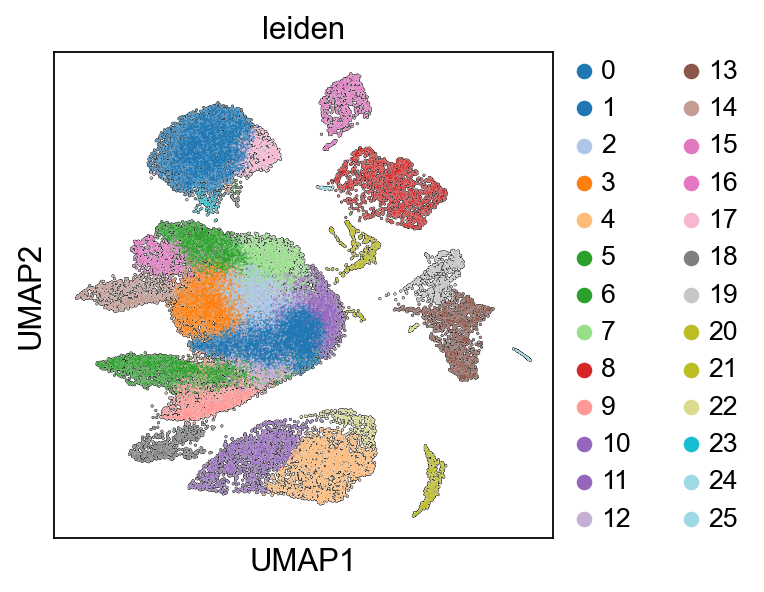

In [35]:
sc.pl.umap(
    adata,
    color="leiden",
    add_outline=True,
    legend_loc="right margin",
    legend_fontsize=12,
    legend_fontoutline=2,  # frameon=False,
    palette="tab20",
)

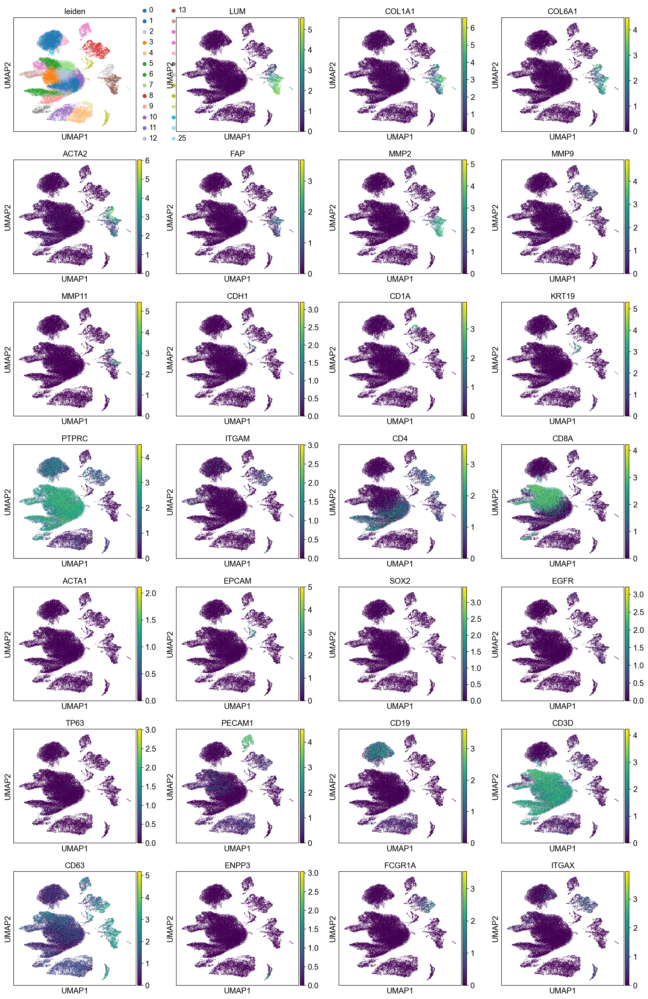

In [36]:
sc.pl.umap(
    adata,
    color=[
        "leiden",
        "LUM",
        "COL1A1",
        "COL6A1",
        "ACTA2",
        "FAP",
        "MMP2",
        "MMP9",
        "MMP11",
        "CDH1",
        "CD1A",
        "KRT19",
        "PTPRC",
        "ITGAM",
        "CD4",
        "CD8A",
        "ACTA1",
        "EPCAM",
        "SOX2",
        "EGFR",
        "TP63",
        "PECAM1",
        "CD19",
        "CD3D",
        "CD63",
        "ENPP3",
        "FCGR1A",
        "ITGAX",
    ],
)

In [37]:
# # ranking of genes for every cluster
# sc.settings.verbosity = 2
# sc.tl.rank_genes_groups(adata, "leiden", method="wilcoxon")
# sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
# sc.tl.rank_genes_groups(adata, "leiden", method="logreg")
# sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [38]:
# removing batch effect
import harmonypy as hm

In [39]:
ho = hm.run_harmony(adata.obsm["X_pca"], adata.obs, ["sample"])

2022-02-09 19:15:00,338 - harmonypy - INFO - Iteration 1 of 10
2022-02-09 19:15:16,232 - harmonypy - INFO - Iteration 2 of 10
2022-02-09 19:15:34,746 - harmonypy - INFO - Iteration 3 of 10
2022-02-09 19:15:54,976 - harmonypy - INFO - Converged after 3 iterations


In [40]:
# Write the adjusted PCs to the AnnData object
adata.obsm["X_harmony"] = ho.Z_corr.T

## Clustering 

In [41]:
sc.pp.neighbors(adata, use_rep="X_harmony")
sc.tl.umap(adata, random_state=101)

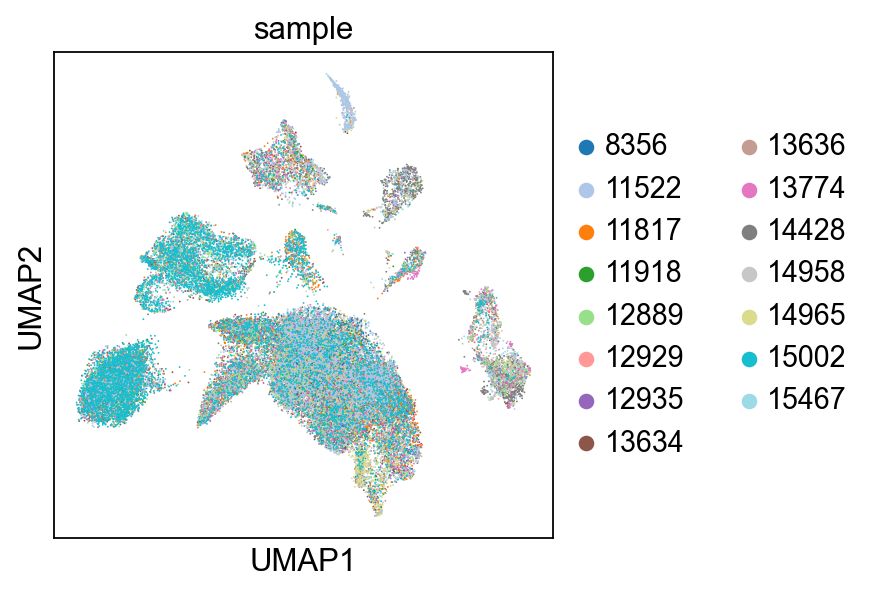

In [42]:
sc.pl.umap(adata, color=["sample"], palette="tab20")

In [43]:
# clustering after batch correction
sc.tl.leiden(adata, random_state=101)

ranking genes
    finished (0:01:26)


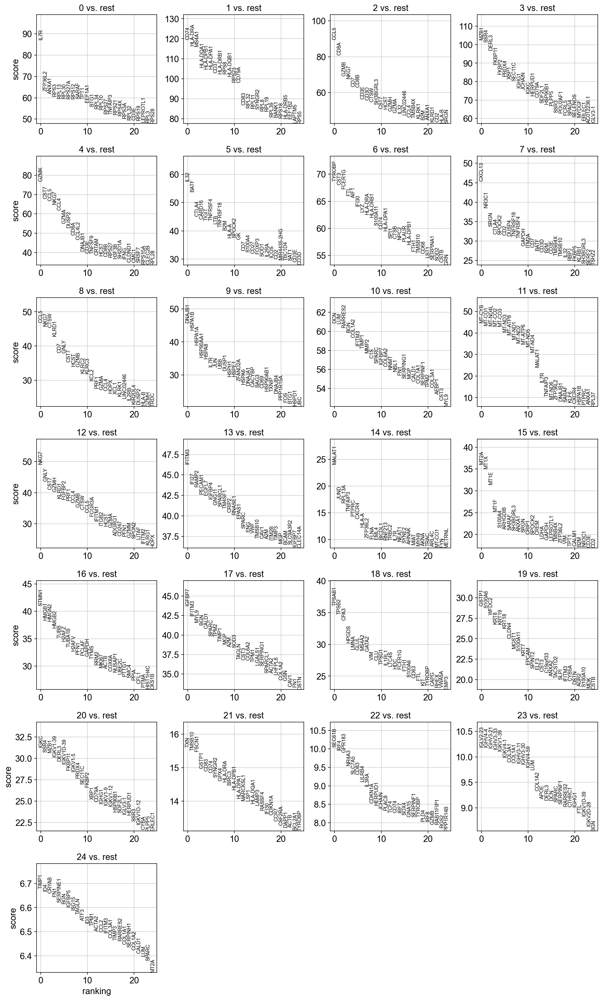

In [44]:
sc.settings.verbosity = 2  # reduce the verbosity
# clusters genes ranking
sc.tl.rank_genes_groups(adata, "leiden", method="wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


{'heatmap_ax': <AxesSubplot:>,
 'groupby_ax': <AxesSubplot:xlabel='leiden'>,
 'dendrogram_ax': <AxesSubplot:>,
 'gene_groups_ax': <AxesSubplot:>}

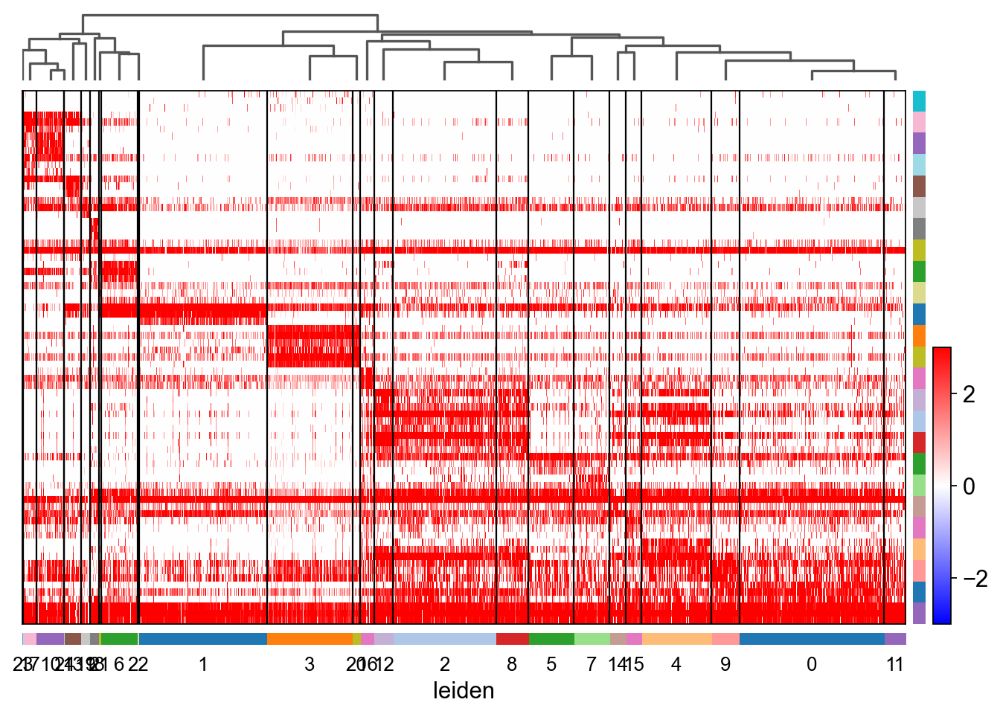

In [45]:
sc.pl.rank_genes_groups_heatmap(
    adata.raw.to_adata(),
    n_genes=3,
    use_raw=False,
    swap_axes=True,
    vmin=-3,
    vmax=3,
    cmap="bwr",
    figsize=(10, 7),
    show=False,
)

In [46]:
# write results
adata.write(results_file)

## Automatic annotation

In [47]:
# Automatic cell type annotation
sys.path.append("../../../scoreCT/src/")
import scorect_api as ct

In [48]:
def get_markers_from_db(species, tissue, url=None):
    """
    Get reference from Cell Marker Database
    """
    if url is None:
        url = "http://biocc.hrbmu.edu.cn/CellMarker/download/all_cell_markers.txt"
    req = requests.get(url)
    parsed_file = []
    for chunk in req.iter_lines():
        chunk = chunk.decode("utf-8").split("\t")
        parsed_file.append(chunk)

    marker_df = pd.DataFrame(columns=parsed_file[0], data=parsed_file[1:])

    # Subset for interesting information
    sub_df = marker_df[marker_df["speciesType"] == species]
    # sub_df = sub_df[sub_df['tissueType'] == tissue]

    # Parse information to create new reference
    list_ct = sub_df["cellName"].unique().tolist()
    # Use re to remove special characters
    dict_marker = {
        ct: [
            re.split("\W+", gene)
            for gene in sub_df[sub_df["cellName"] == ct]["geneSymbol"].unique().tolist()
        ]
        for ct in list_ct
    }

    # merge nested lists without spelling strings
    for ct in dict_marker.keys():
        dict_marker[ct] = list(
            itertools.chain.from_iterable(
                itertools.repeat(x, 1) if isinstance(x, str) else x
                for x in dict_marker[ct]
            )
        )

    # Use dict to initialize df. Here order in memory doesn't mess with loading.
    ref_df = pd.DataFrame({ct: pd.Series(genes) for ct, genes in dict_marker.items()})
    return ref_df

In [49]:
# ref_marker = get_markers_from_db(species='Human', tissue=None, url=None) # option tissue=None home-made
ref_marker = ct.get_markers_from_db(
    species="Human", tissue="Lung", url=None
)  # option tissue=None home-made

In [50]:
marker_df = ct.wrangle_ranks_from_anndata(adata)
print(marker_df.head())

Wrangling: Number of markers used in ranked_gene_groups:  23905
Wrangling: Groups used for ranking: leiden
     z_score  adj_pvals     gene cluster_number
0  87.259064        0.0     IL7R              0
1  63.116814        0.0  ZFP36L2              0
2  61.727852        0.0    ANXA1              0
3  60.644665        0.0     RPS3              0
4  59.619991        0.0    RPL13              0


In [51]:
# Score cell types for each cluster
# Let's set parameters first - K represents the number of genes included in the ranking
# m represents the number of bins used to divide the top K genes.
K = 300
m = 5
# Get the background genes - here, all the genes used to run the differential gene expression test
background = adata.raw.var.index.tolist()
# Now run the function
ct_pval, ct_score = ct.celltype_scores(
    nb_bins=m,
    ranked_genes=marker_df,
    K_top=K,
    marker_ref=ref_marker,
    background_genes=background,
)

... storing 'scorect' as categorical


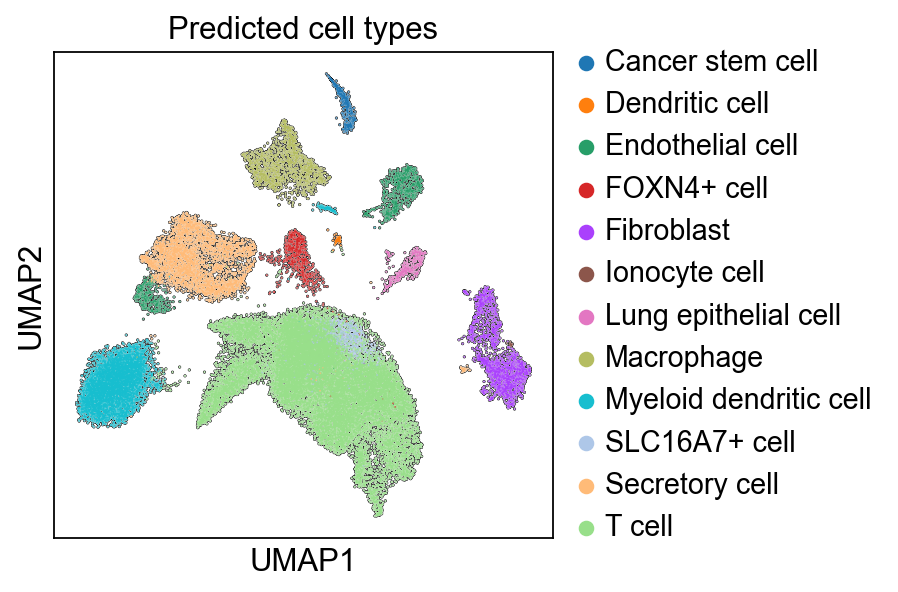

In [52]:
# Now assign clusters to cell types
cluster_assign = adata.obs["leiden"]
celltype_assign = ct.assign_celltypes(
    cluster_assignment=cluster_assign,
    ct_pval_df=ct_pval,
    ct_score_df=ct_score,
    cutoff=0.1,
)
# Add to anndata object
adata.obs["scorect"] = celltype_assign
# Let's compare with the true assignment now!
sc.pl.umap(
    adata,
    color=["scorect"],
    title=["Predicted cell types"],
    cmap="Set2",
    add_outline=True,
)

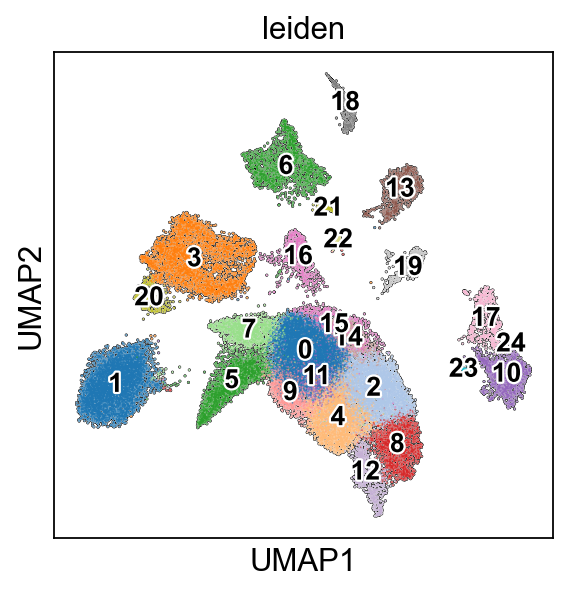

In [53]:
sc.pl.umap(
    adata,
    color=["leiden"],
    edges_color="black",
    cmap="Set2",
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
)

In [54]:
df_ann = pd.merge(
    cluster_assign.to_frame(),
    celltype_assign.to_frame(),
    left_index=True,
    right_index=True,
)

In [55]:
df_ann = df_ann.drop_duplicates(subset=["leiden_x"])

In [56]:
df_ann

,leiden_x,leiden_y
AAACCTGAGCTTTGGT-1,2,T cell
AAACCTGCACCAGGCT-1,5,T cell
AAACGGGGTACTCTCC-1,6,Macrophage
AAACGGGTCGACCAGC-1,0,T cell
AAAGCAACACCTTGTC-1,4,T cell
AAAGTAGAGGCCCTCA-1,12,T cell
AAATGCCTCGAGGTAG-1,1,Myeloid dendritic cell
AACACGTGTCTGGAGA-1,17,Fibroblast
AACCATGGTTATTCTC-1,13,Endothelial cell
AACCGCGTCTAGAGTC-1,10,Fibroblast


## Manual annotation

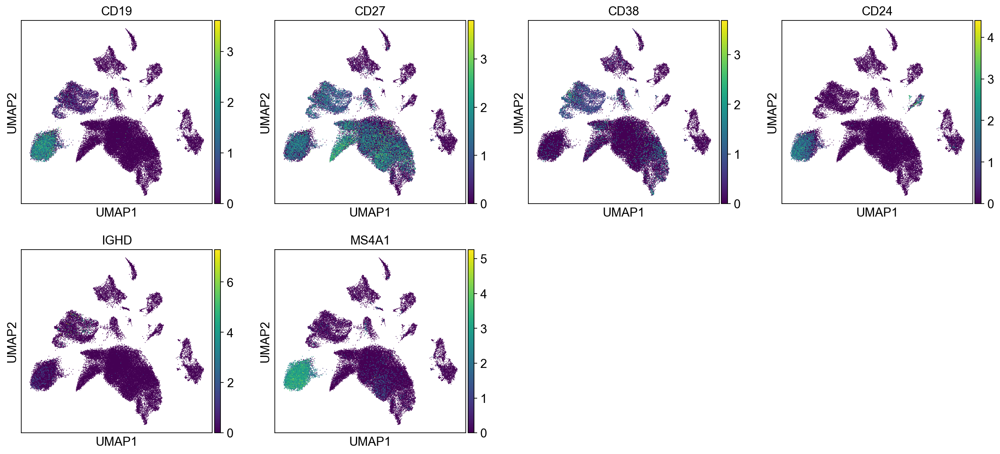

In [57]:
# B cells
sc.pl.umap(adata, color=["CD19", "CD27", "CD38", "CD24", "IGHD", "MS4A1"])

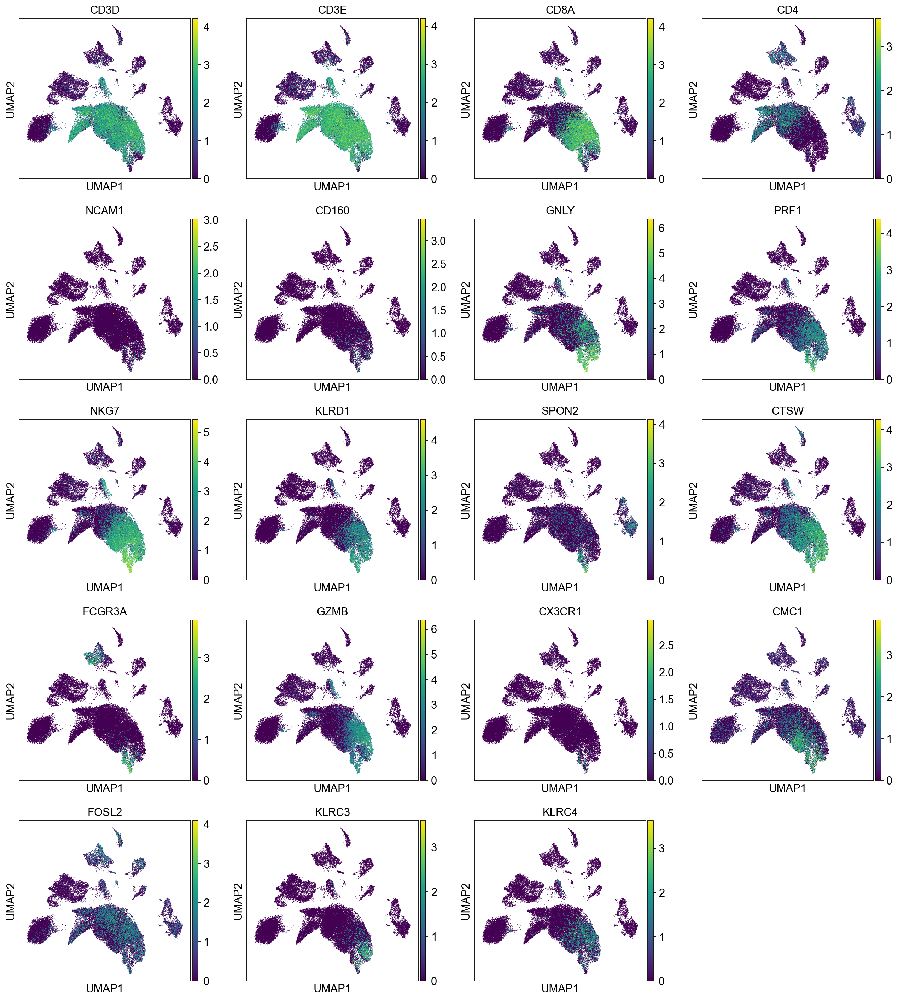

In [58]:
# T cells, NK cells
sc.pl.umap(
    adata,
    color=[
        "CD3D",
        "CD3E",
        "CD8A",
        "CD4",
        "NCAM1",
        "CD160",
        "GNLY",
        "PRF1",
        "NKG7",
        "KLRD1",
        "SPON2",
        "CTSW",
        "FCGR3A",
        "GZMB",
        "CX3CR1",
        "CMC1",
        "FOSL2",
        "KLRC3",
        "KLRC4",
    ],
)

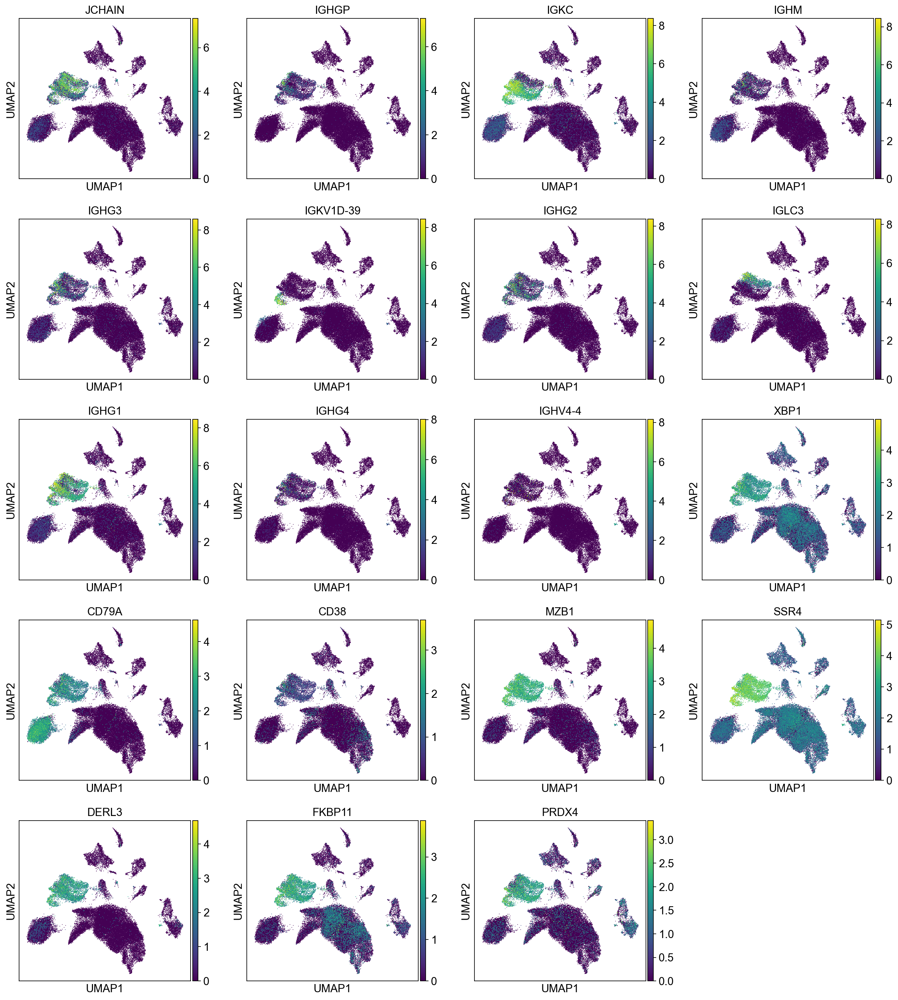

In [59]:
# plasma cells
sc.pl.umap(
    adata,
    color=[
        "JCHAIN",
        "IGHGP",
        "IGKC",
        "IGHM",
        "IGHG3",
        "IGKV1D-39",
        "IGHG2",
        "IGLC3",
        "IGHG1",
        "IGHG4",
        "IGHV4-4",
        "XBP1",
        "CD79A",
        "CD38",
        "MZB1",
        "SSR4",
        "DERL3",
        "FKBP11",
        "PRDX4",
    ],
)

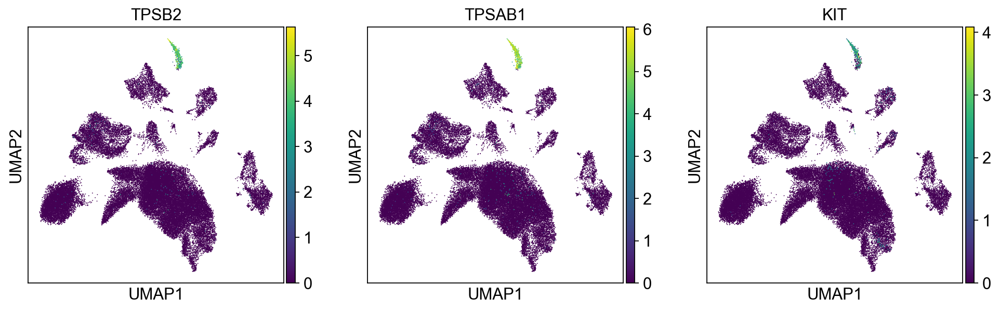

In [60]:
# Mast cells
sc.pl.umap(adata, color=["TPSB2", "TPSAB1", "KIT"])

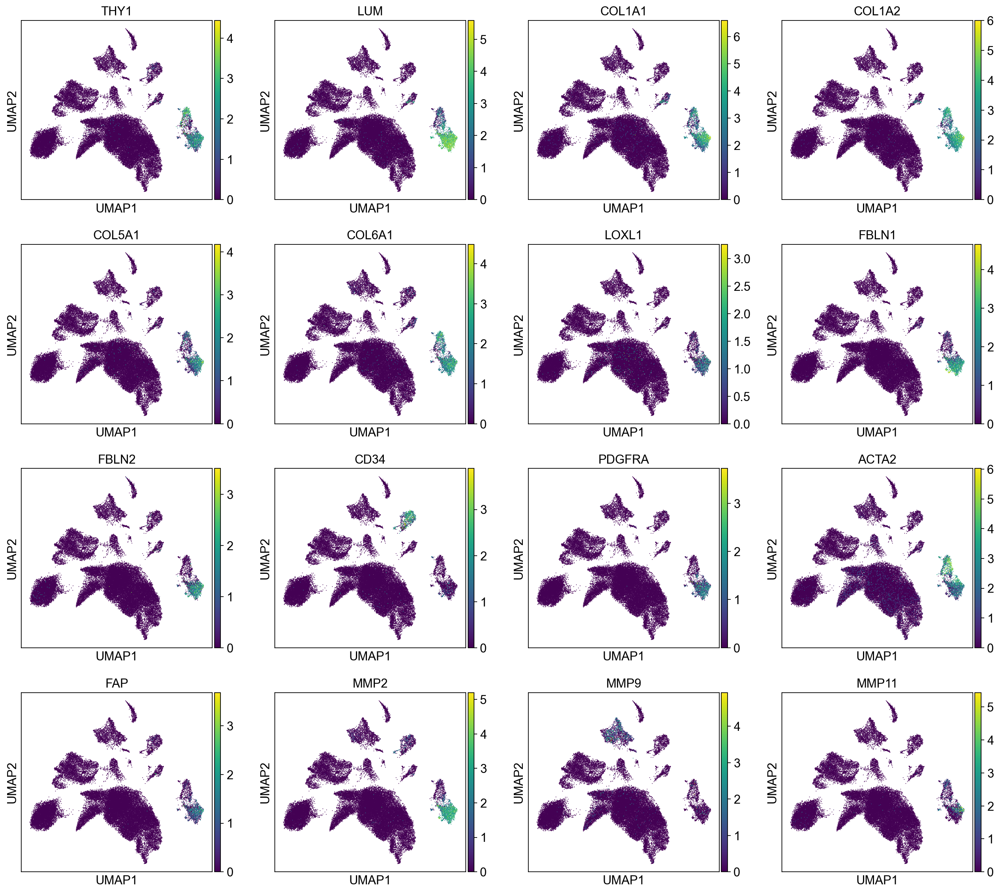

In [61]:
# Fibroblasts
sc.pl.umap(
    adata,
    color=[
        "THY1",
        "LUM",
        "COL1A1",
        "COL1A2",
        "COL5A1",
        "COL6A1",
        "LOXL1",
        "FBLN1",
        "FBLN2",
        "CD34",
        "PDGFRA",
        "ACTA2",
        "FAP",
        "MMP2",
        "MMP9",
        "MMP11"
        #'ITGA2', 'PLAUR', 'FAS', # Cancer associated
    ],
)

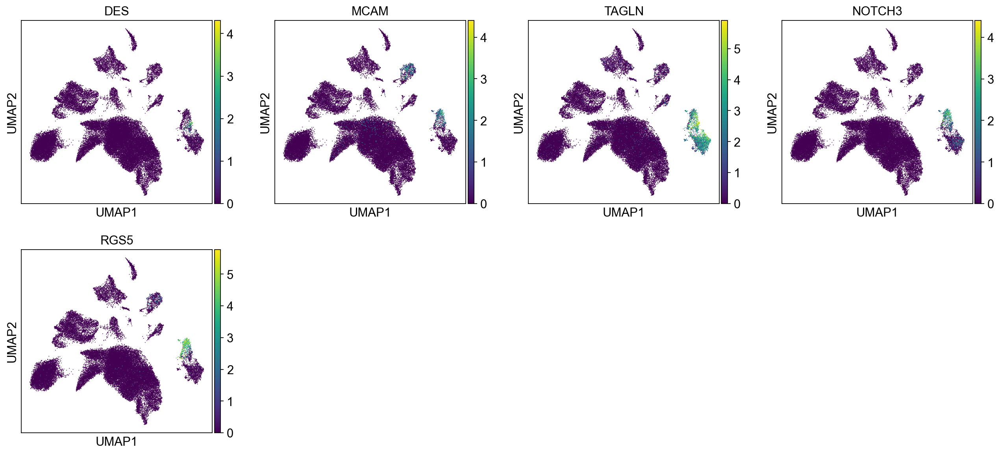

In [62]:
sc.pl.umap(adata, color=["DES", "MCAM", "TAGLN", "NOTCH3", "RGS5"])

In [63]:
# Cluster annotation
cluster2annotation = {
    "0": "CD4+ T cells",
    "1": "B cells",
    "2": "CD8+ T cells",
    "3": "Plasma B cells",
    "4": "CD8+ T cells",
    "5": "T reg. cells",
    "6": "Myeloid cells",
    "7": "T helper cells",
    "8": "CD8+ T cells",
    "9": "CD4+ T cells",
    "10": "Fibroblasts",
    "11": "CD4+ T cells",
    "12": "NK cells",
    "13": "Endothelial cells",
    "14": "CD4+ T cells",
    "15": "CD4+ T cells",
    "16": "T cells proliferative",
    "17": "Mural cells",
    "18": "Mast cells",
    "19": "Epithelial/Cancer",
    "20": "Plasma B cells",
    "21": "Myeloid cells",
    "22": "Myeloid cells",
    "23": "Fibroblasts",
    "24": "Fibroblasts",
}

adata.obs["annotated_ct"] = (
    adata.obs["leiden"].map(cluster2annotation).astype("category")
)

In [7]:
# Cluster annotation
cluster2annotation = {
    "0": "T cells",
    "1": "B cells",
    "2": "T cells",
    "3": "B cells",
    "4": "T cells",
    "5": "T cells",
    "6": "Myeloid cells",
    "7": "T cells",
    "8": "T cells",
    "9": "T cells",
    "10": "Fibroblasts",
    "11": "T cells",
    "12": "T cells",  # "NK cells",
    "13": "Endothelial cells",
    "14": "T cells",
    "15": "T cells",
    "16": "T cells",
    "17": "Mural cells",
    "18": "Myeloid cells",
    "19": "Cancer cells",
    "20": "B cells",
    "21": "Myeloid cells",
    "22": "Myeloid cells",
    "23": "Fibroblasts",
    "24": "Fibroblasts",
}

adata.obs["annotated_ct_higher"] = (
    adata.obs["leiden"].map(cluster2annotation).astype("category")
)

In [8]:
adata.obs

,sample,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,scorect,annotated_ct,annotated_ct_higher,SILA_score,Group,cluster,Hist_predominant,X8th_ed_path_stage
AAACCTGAGCTTTGGT-1,12929,749,749,1814.0,68.0,3.748622,2,T cell,CD8+ T cells,T cells,0.622,Aggressive,4,acinar,Stage IIB
AAACCTGCACCAGGCT-1,12929,1572,1572,3813.0,102.0,2.675059,5,T cell,T reg. cells,T cells,0.622,Aggressive,4,acinar,Stage IIB
AAACGGGGTACTCTCC-1,12929,1381,1381,4512.0,251.0,5.562943,6,Macrophage,Myeloid cells,Myeloid cells,0.622,Aggressive,4,acinar,Stage IIB
AAACGGGTCGACCAGC-1,12929,854,854,1641.0,83.0,5.057891,0,T cell,CD4+ T cells,T cells,0.622,Aggressive,4,acinar,Stage IIB
AAAGCAAAGACAAGCC-1,12929,1266,1266,3756.0,85.0,2.263046,2,T cell,CD8+ T cells,T cells,0.622,Aggressive,4,acinar,Stage IIB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTCTCTCGT-1,15002,1999,1999,19997.0,175.0,0.875131,3,Secretory cell,Plasma B cells,B cells,0.724,Aggressive,4,solid,Stage IIA
TTTGTCATCAACTCTT-1,15002,275,275,755.0,9.0,1.192053,3,Secretory cell,Plasma B cells,B cells,0.724,Aggressive,4,solid,Stage IIA
TTTGTCATCCATGAAC-1,15002,825,825,2099.0,42.0,2.000953,1,Myeloid dendritic cell,B cells,B cells,0.724,Aggressive,4,solid,Stage IIA
TTTGTCATCGGCGGTT-1-1,15002,2186,2186,18243.0,249.0,1.364907,3,Secretory cell,Plasma B cells,B cells,0.724,Aggressive,4,solid,Stage IIA


In [9]:
# series with sample names (pt_IDs)
sc_samp = adata.obs["sample"].unique()
sc_samp = pd.Series(sc_samp).astype(str)

In [10]:
# read clinical data and filter samples
cde = pd.read_csv("../../data/TMA36_project/CDE/CDE_TMA36_2021SEPT21_DR_MF_forMxIF.csv")
cde["cluster"] = cde["cluster"].fillna(0).astype(int)
cde["pt_ID"] = cde["pt_ID"].astype("str")
cde.set_index("pt_ID", inplace=True)
cde = cde.loc[sc_samp]

In [68]:
adata.obs = adata.obs.merge(
    cde[["SILA_score", "Group", "cluster", "Hist_predominant", "X8th_ed_path_stage"]],
    left_on="sample",
    right_index=True,
)

In [11]:
adata.obs.shape

(44876, 15)

In [12]:
adata.obs["Group"]

AAACCTGAGCTTTGGT-1      Aggressive
AAACCTGCACCAGGCT-1      Aggressive
AAACGGGGTACTCTCC-1      Aggressive
AAACGGGTCGACCAGC-1      Aggressive
AAAGCAAAGACAAGCC-1      Aggressive
                           ...    
TTTGTCAGTCTCTCGT-1      Aggressive
TTTGTCATCAACTCTT-1      Aggressive
TTTGTCATCCATGAAC-1      Aggressive
TTTGTCATCGGCGGTT-1-1    Aggressive
TTTGTCATCTGGGCCA-1      Aggressive
Name: Group, Length: 44876, dtype: category
Categories (3, object): ['Indolent', 'Intermediate', 'Aggressive']

In [13]:
adata.write(results_file)

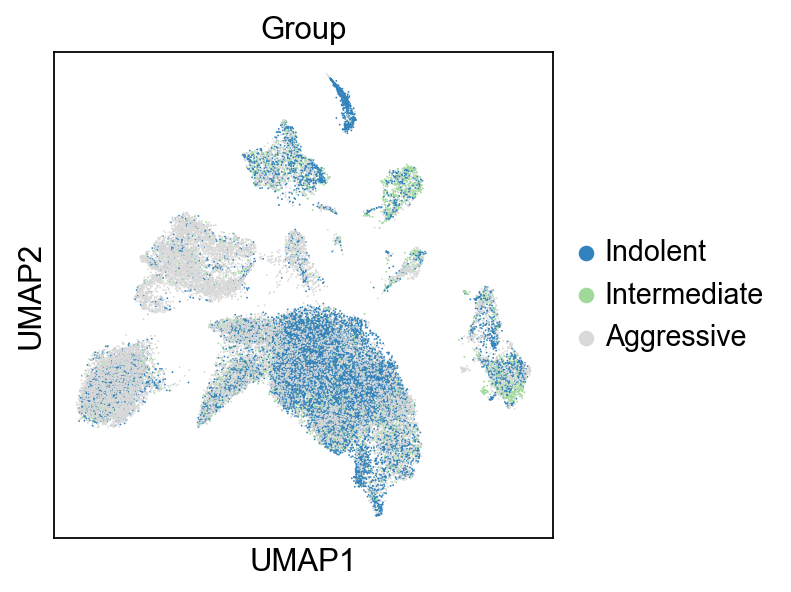

In [14]:
# sc.pl.umap(adata, color="Group", palette="tab20c")
adata.obs["Group"].cat.reorder_categories(
    ["Indolent", "Intermediate", "Aggressive"], inplace=True
)
sc.pl.umap(adata, color="Group", palette="tab20c")

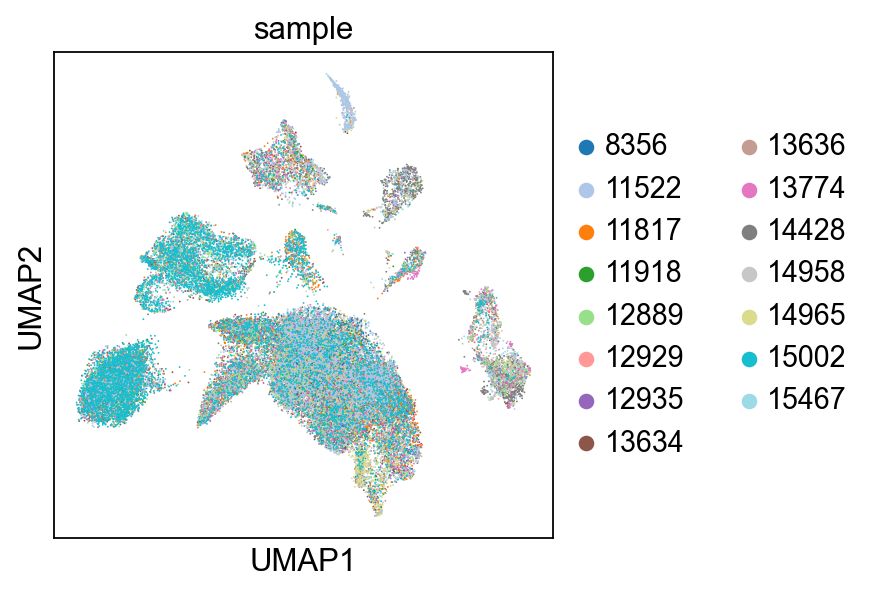

In [15]:
sc.pl.umap(adata, color="sample", palette="tab20")

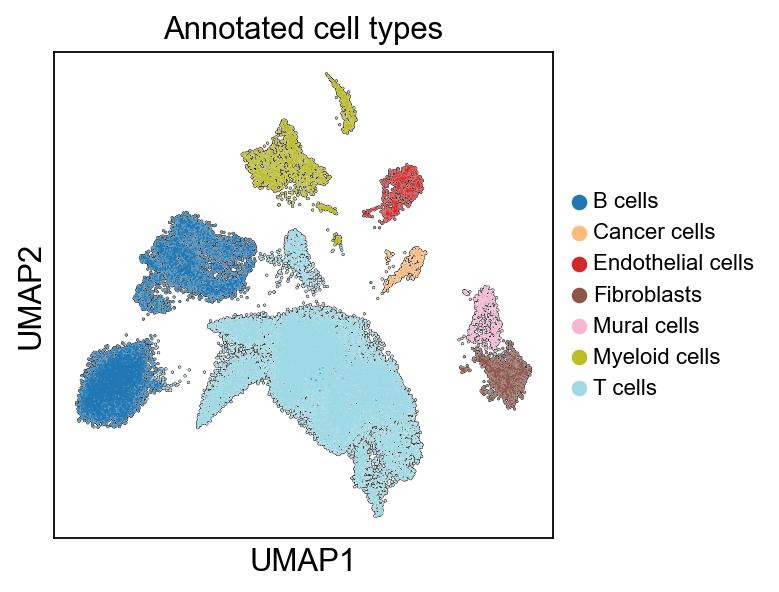

In [17]:
sc.pl.umap(
    adata,
    color=["annotated_ct_higher"],
    title=["Annotated cell types"],
    edges_color="black",
    legend_fontsize=10,
    # legend_fontoutline=2,
    palette="tab20",
    add_outline=True,
)

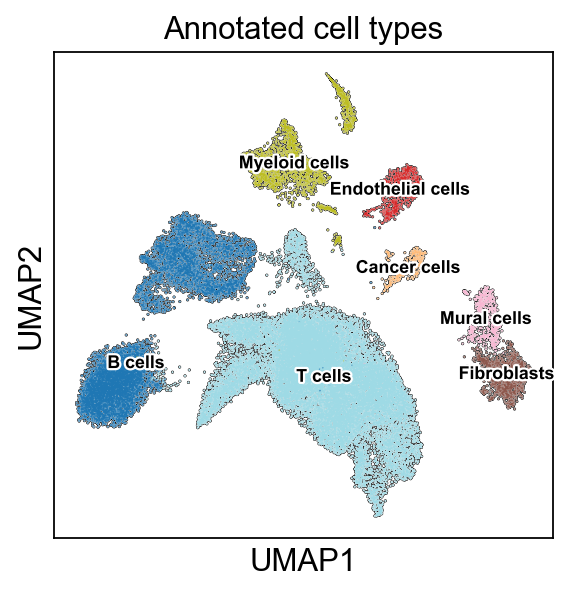

In [18]:
sc.pl.umap(
    adata,
    color=["annotated_ct_higher"],
    title=["Annotated cell types"],
    edges_color="black",
    legend_loc="on data",
    legend_fontsize=8,
    legend_fontoutline=2,
    palette="tab20",
    add_outline=True,
)

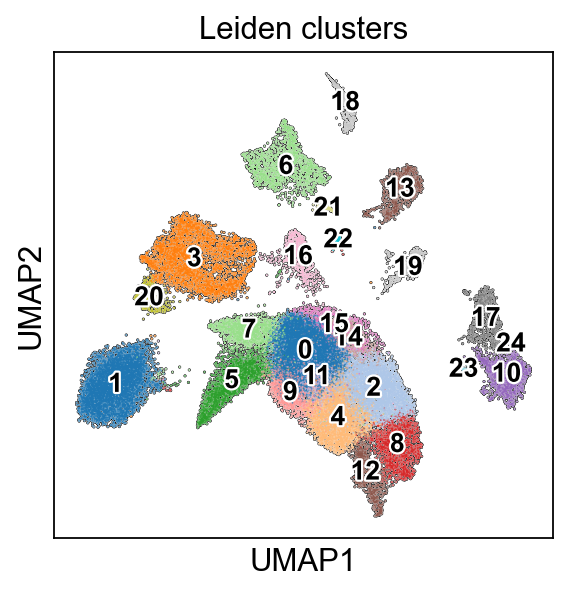

In [19]:
sc.pl.umap(
    adata,
    color=["leiden"],
    title=["Leiden clusters"],
    edges_color="black",
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    palette="tab20",
)

In [20]:
adata.write(results_file)

In [6]:
adata = sc.read(results_file)

# Downstream analysis

## Compare cell types and clusters

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:09)
CD8+ T cells


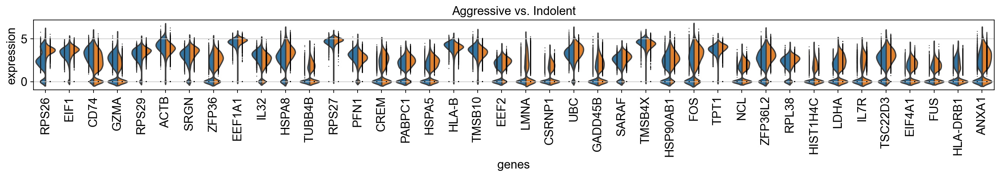

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:02)
T reg. cells


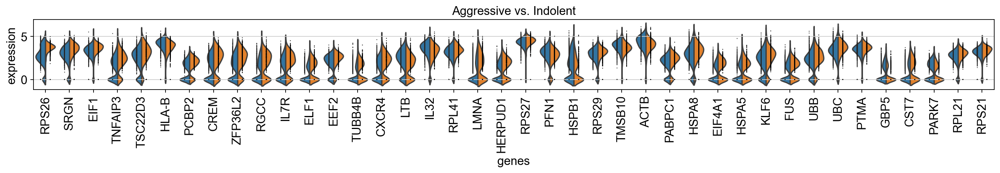

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:01)
Myeloid cells


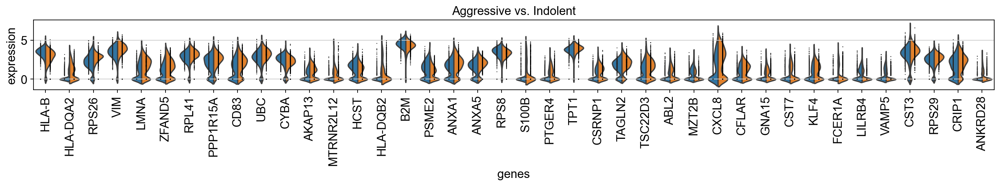

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:11)
CD4+ T cells


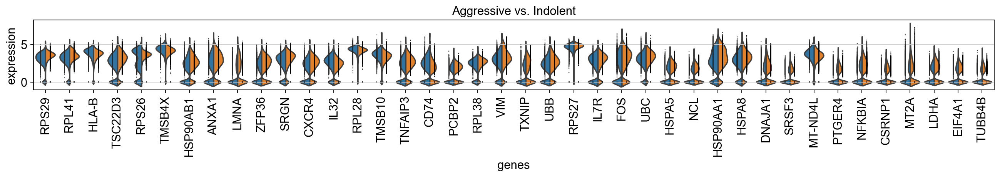

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
NK cells


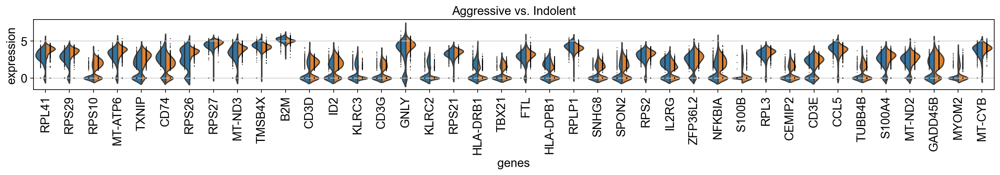

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:07)
B cells


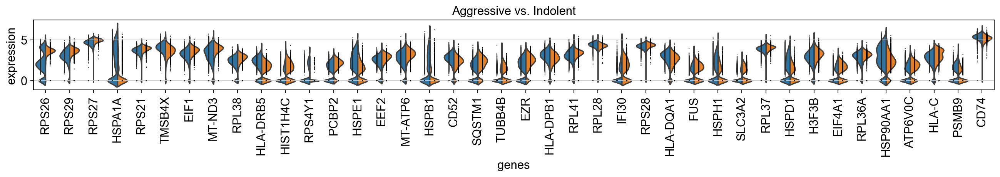

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Mural cells


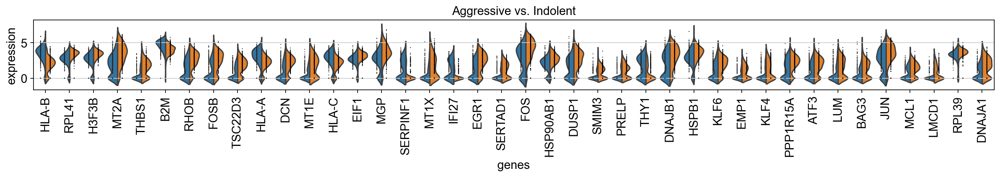

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Endothelial cells


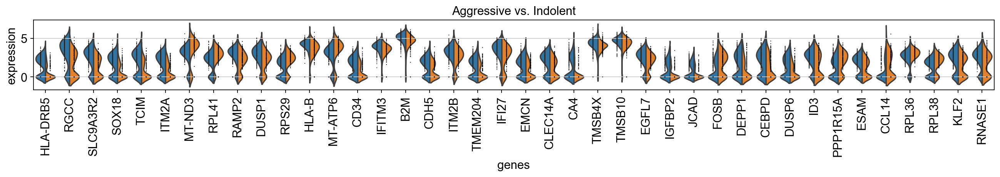

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Fibroblasts


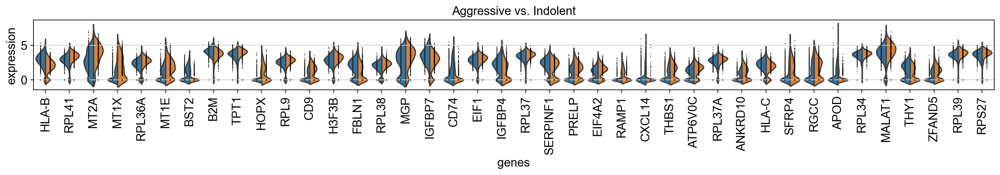

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:06)
Plasma B cells


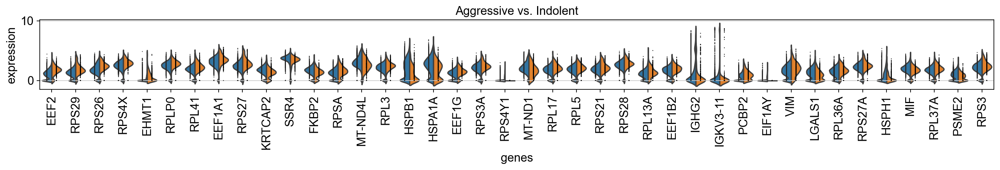

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:01)
T helper cells


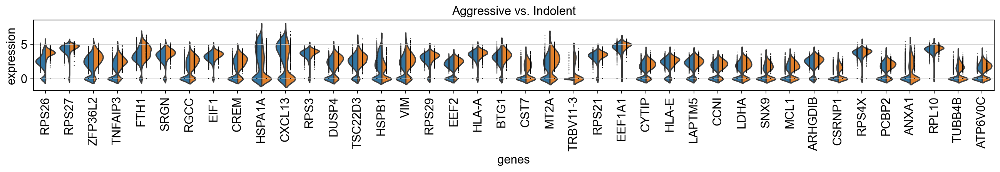

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Epithelial/Cancer


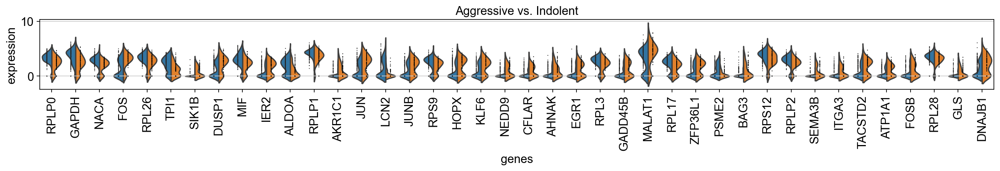

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
T cells proliferative


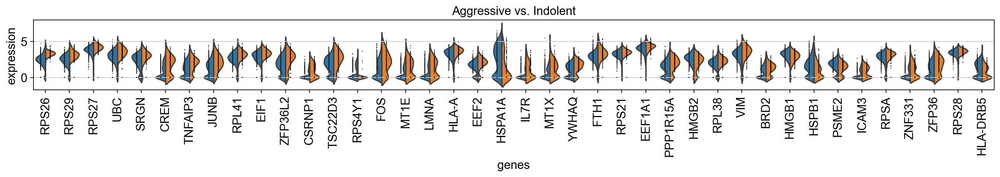

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Mast cells


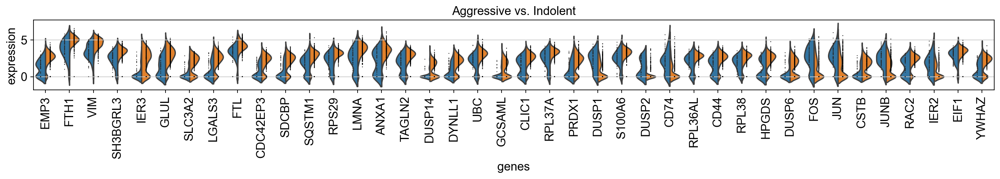

In [386]:
sc.settings.verbosity = 2  # reduce the verbosity

# Dictionary containing the set of DataFrames
df_dict_group = {}

for idx, ct in enumerate(adata.obs["annotated_ct"].unique()):
    # if idx == 1:
    #     break
    adata_ct = adata[adata.obs["annotated_ct"] == ct]
    sc.tl.rank_genes_groups(
        adata_ct,
        groupby="Group",
        groups=["Indolent", "Aggressive"],
        reference="Indolent",
        method="wilcoxon",
        rankby_abs=True,
    )
    print(ct)
    # Violin plots
    with plt.rc_context({"figure.figsize": (20, 1.5)}):
        sc.pl.rank_genes_groups_violin(adata_ct, n_genes=40, jitter=False)
    # get table
    t = sc.get.rank_genes_groups_df(adata_ct, group="Aggressive")
    # Saving DataFrame to dictionary
    df_dict_group[ct] = t.reindex(t.scores.abs().sort_values(ascending=False).index)

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:07)
CD8+ T cells


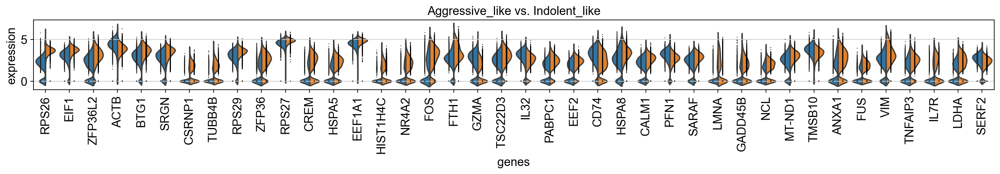

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:01)
T reg. cells


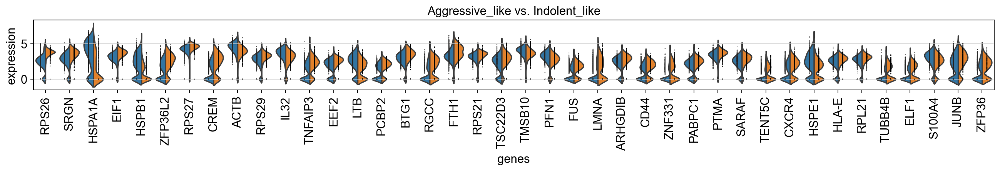

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Myeloid cells


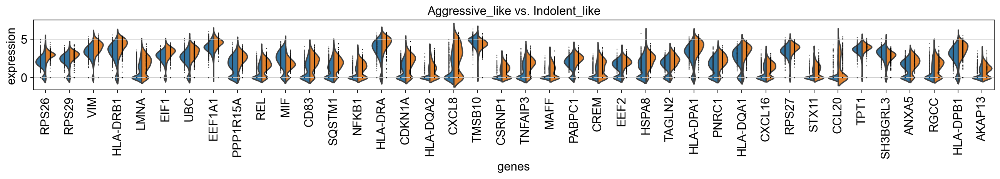

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:07)
CD4+ T cells


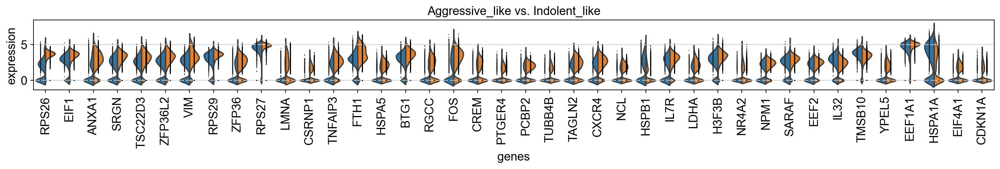

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
NK cells


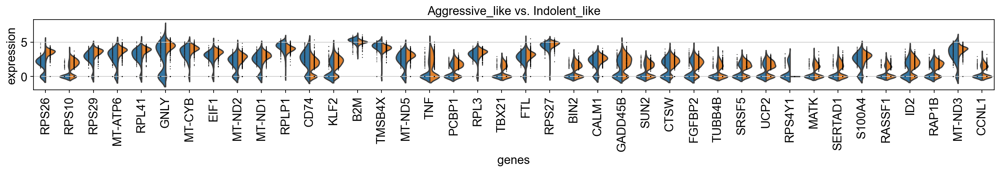

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:05)
B cells


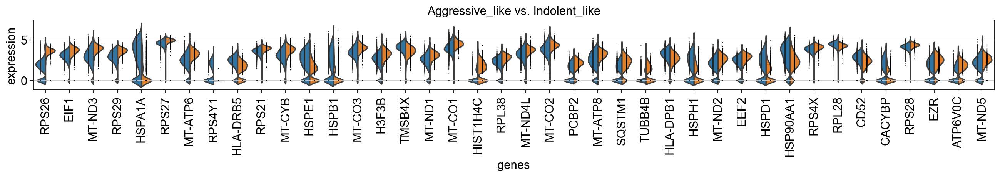

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Mural cells


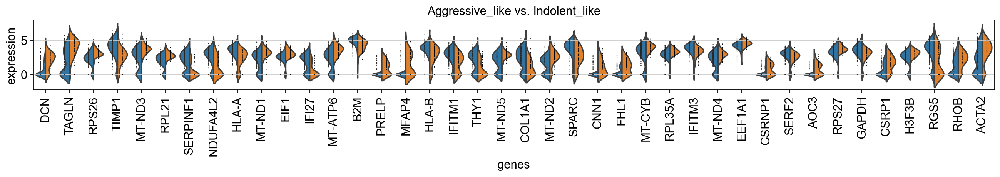

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Endothelial cells


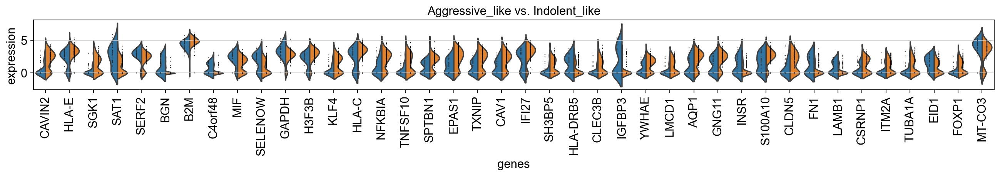

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Fibroblasts


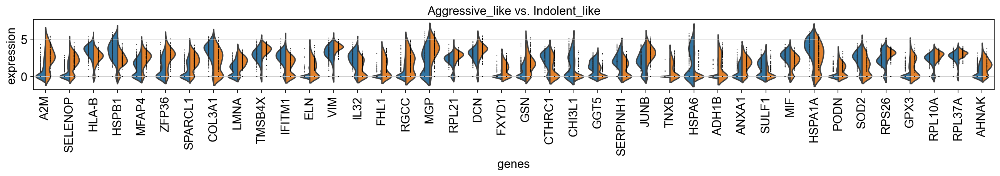

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:04)
Plasma B cells


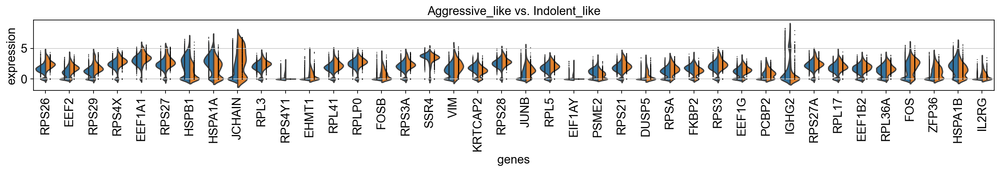

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:01)
T helper cells


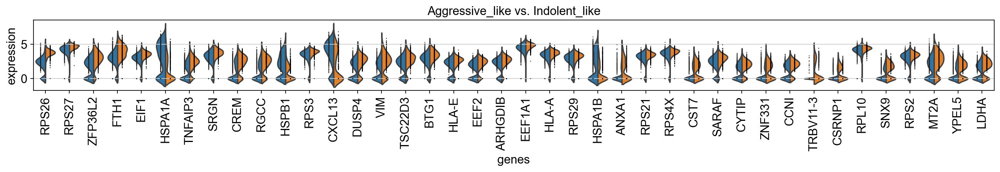

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Epithelial/Cancer


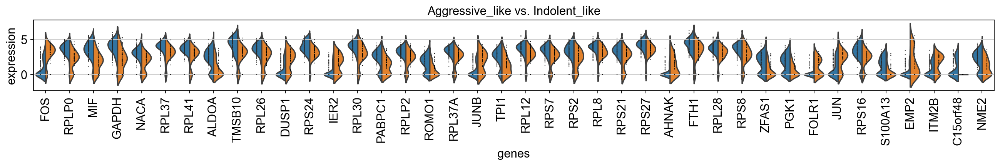

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
T cells proliferative


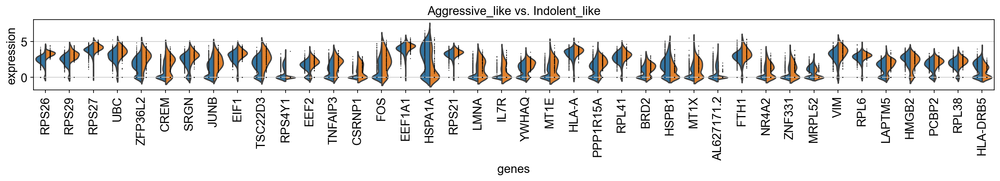

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished (0:00:00)
Mast cells


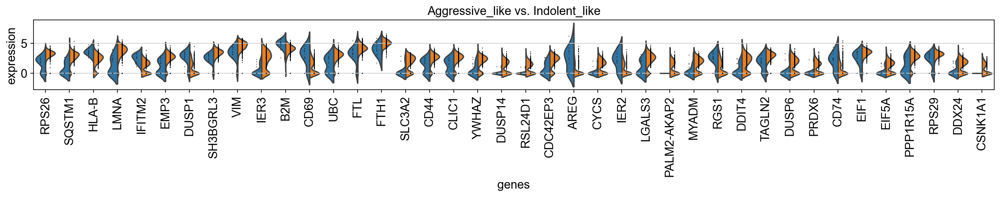

In [385]:
# Dictionary containing the set of DataFrames
df_dict_newclass = {}

for idx, ct in enumerate(adata.obs["annotated_ct"].unique()):
    # if idx == 1:
    #     break
    adata_ct = adata[adata.obs["annotated_ct"] == ct]
    sc.tl.rank_genes_groups(
        adata_ct,
        groupby="new_class",
        groups=["Indolent_like", "Aggressive_like"],
        reference="Indolent_like",
        method="wilcoxon",
        rankby_abs=True,
    )
    print(ct)
    # Violin plots
    with plt.rc_context({"figure.figsize": (20, 1.5)}):
        sc.pl.rank_genes_groups_violin(adata_ct, n_genes=40, jitter=False)
    # get table
    t = sc.get.rank_genes_groups_df(adata_ct, group="Aggressive_like")
    # Saving DataFrame to dictionary
    df_dict_newclass[ct] = t.reindex(t.scores.abs().sort_values(ascending=False).index)

In [324]:
df_dict_newclass["CD8+ T cells"].head(30)

,names,scores,logfoldchanges,pvals,pvals_adj
23904,RPS26,-59.807457,-2.566690,0.000000e+00,0.000000e+00
23903,EIF1,-40.692669,-1.117758,0.000000e+00,0.000000e+00
23902,ZFP36L2,-32.950562,-1.604501,4.152607e-238,3.308935e-234
0,ACTB,31.572161,0.758145,8.902909e-219,5.320601e-215
23901,BTG1,-31.439896,-1.122873,5.769415e-217,2.758357e-213
23900,SRGN,-30.524294,-1.108495,1.240761e-204,4.943400e-201
23899,CSRNP1,-30.273279,-2.452279,2.577258e-201,8.801335e-198
23898,TUBB4B,-30.143051,-2.324572,1.322923e-199,3.953058e-196
23897,RPS29,-30.005323,-0.886063,8.363299e-198,2.221385e-194
23896,ZFP36,-29.085827,-1.776098,5.424457e-186,1.296716e-182


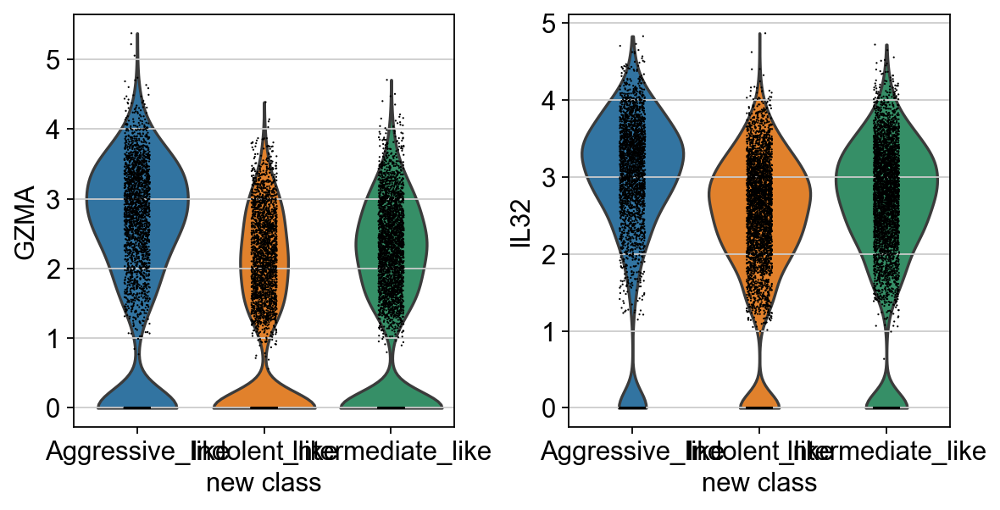

In [366]:
sc.pl.violin(
    adata[adata.obs["annotated_ct"] == "CD8+ T cells"],
    ["GZMA", "IL32"],
    groupby="new_class",
)